In [25]:
import numpy as np
import pandas as pd
import collections #used for counting items of a list
import tensorflow as tf
from tensorflow import keras
from keras import layers
from keras.datasets import mnist, fashion_mnist
import matplotlib.pyplot as plt
from tensorflow import keras
import json
from PIL import Image
from tensorflow.keras.preprocessing.image import ImageDataGenerator


ModuleNotFoundError: No module named 'sklearn'

In [3]:
# check if tensorflow is running on gpu
if tf.test.gpu_device_name():
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))
else:
    print("Please install GPU version of TF")


Default GPU Device: /device:GPU:0


In [15]:
train_dir = './img/train/'

test_dir = './img/test/'

In [16]:
sample_generator = ImageDataGenerator(rescale = 1./255,
                                     horizontal_flip = True,
                                     vertical_flip = True,
                                     rotation_range = 90,
                                     height_shift_range = 0.2,
                                     width_shift_range = 0.2)

sample_images = sample_generator.flow_from_directory(train_dir,
                                                   target_size = (300, 300),
                                                   color_mode = 'rgb',
                                                   class_mode = None,
                                                   batch_size = 1,
                                                   shuffle = True,
                                                   seed = 42)



Found 2520 images belonging to 3 classes.


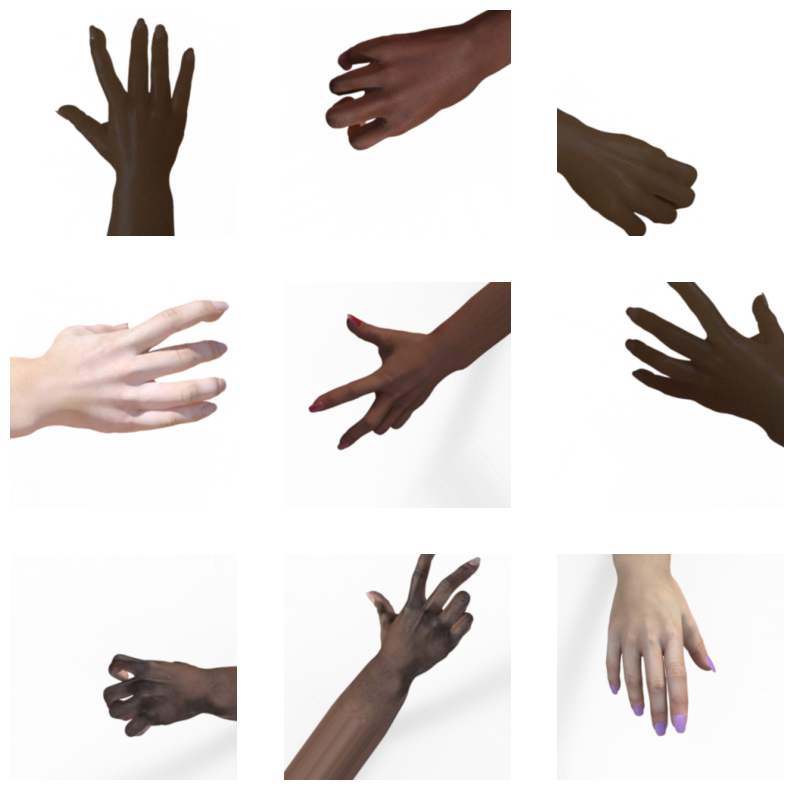

In [17]:
plt.figure(figsize = (10, 10))

for i in range(9):
    plt.subplot(3, 3, i + 1)
    img = sample_images.next()[0]
    plt.imshow(img)
    plt.axis('off')
    
plt.show()

In [18]:
train_generator = ImageDataGenerator(rescale = 1./255,
                                    horizontal_flip = True,
                                    vertical_flip = True,
                                    rotation_range = 90,
                                    height_shift_range = 0.2,
                                    width_shift_range = 0.2,
                                    zoom_range = 0.2)
test_generator = ImageDataGenerator(rescale = 1./255,
                                   validation_split = 0.7)

In [19]:
train_images = train_generator.flow_from_directory(train_dir,
                                                  target_size=(150, 150),
                                                  color_mode = 'rgb',
                                                  class_mode = 'categorical',
                                                  batch_size = 32,
                                                  shuffle = True,
                                                  seed = 42,
                                                  subset = 'training')
val_images = test_generator.flow_from_directory(test_dir,
                                                target_size=(150, 150),
                                                color_mode='rgb',
                                                class_mode='categorical',
                                                batch_size=32,
                                                shuffle=True,
                                                seed=42,
                                                subset='training')
test_images = test_generator.flow_from_directory(test_dir,
                                                target_size = (150, 150),
                                                color_mode='rgb',
                                                class_mode='categorical',
                                                batch_size=32,
                                                shuffle=False,
                                                seed=42,
                                                subset='validation')

Found 2520 images belonging to 3 classes.
Found 114 images belonging to 3 classes.
Found 258 images belonging to 3 classes.


In [20]:
inputs = tf.keras.Input(shape = (150, 150 ,3))
x = tf.keras.layers.Conv2D(filters = 32, kernel_size = (3, 3), activation='relu')(inputs)
x = tf.keras.layers.MaxPool2D()(x)
x = tf.keras.layers.Conv2D(filters = 64, kernel_size = (3, 3), activation='relu')(x)
x = tf.keras.layers.MaxPool2D()(x)
x = tf.keras.layers.Conv2D(filters = 64, kernel_size = (3, 3), activation='relu')(x)
x = tf.keras.layers.MaxPool2D()(x)
x = tf.keras.layers.Conv2D(filters = 128, kernel_size = (3, 3), activation='relu')(x)
x = tf.keras.layers.MaxPool2D()(x)
x = tf.keras.layers.Flatten()(x)
x = tf.keras.layers.Dropout(0.4)(x)
x = tf.keras.layers.Dense(512, activation = 'relu')(x)
outputs = tf.keras.layers.Dense(3, activation = 'softmax')(x)

model = tf.keras.Model(inputs, outputs)

In [21]:
model.compile(optimizer ='adam',
             loss = 'categorical_crossentropy',
             metrics = ['accuracy'])

history = model.fit(train_images,
                   validation_data = val_images,
                   epochs = 100,
                   callbacks = [
                       tf.keras.callbacks.EarlyStopping(
                       monitor = 'val_loss',
                       patience = 5,
                       restore_best_weights = True
                       )
                   ]
)


Epoch 1/100
79/79 [==============================] - 25s 245ms/step - loss: 1.1035 - accuracy: 0.3770 - val_loss: 1.0760 - val_accuracy: 0.5439
Epoch 2/100
79/79 [==============================] - 20s 249ms/step - loss: 1.0355 - accuracy: 0.4631 - val_loss: 1.0081 - val_accuracy: 0.3333
Epoch 3/100
79/79 [==============================] - 19s 237ms/step - loss: 0.8398 - accuracy: 0.6040 - val_loss: 0.6436 - val_accuracy: 0.6053
Epoch 4/100
79/79 [==============================] - 19s 242ms/step - loss: 0.6537 - accuracy: 0.7111 - val_loss: 0.4516 - val_accuracy: 0.7281
Epoch 5/100
79/79 [==============================] - 19s 241ms/step - loss: 0.4963 - accuracy: 0.7996 - val_loss: 0.0949 - val_accuracy: 0.9912
Epoch 6/100
79/79 [==============================] - 18s 233ms/step - loss: 0.4608 - accuracy: 0.8179 - val_loss: 0.3594 - val_accuracy: 0.7807
Epoch 7/100
79/79 [==============================] - 19s 240ms/step - loss: 0.3587 - accuracy: 0.8587 - val_loss: 0.0557 - val_accuracy:

In [28]:
acc = model.evaluate(test_images, verbose=0)[1]
print("Accuracy: {:.2f}%".format(acc * 100))

predictions = np.argmax(model.predict(test_images), axis=1)

Accuracy: 92.25%
9/9 [==============================] - 1s 93ms/step


In [26]:
# """
# How to load and save the model
# """

model.save('./model/model.mdl')
model.save_weights("./model/model.h5")
weights = model.get_weights()

j =json.dumps(pd.Series(weights).to_json(orient='values'), indent=3)
print(j)

model = keras.models.load_model('./model/model.mdl')
model.load_weights("./model/model.h5")

model_json = model.to_json()
print(model_json)

INFO:tensorflow:Assets written to: ./model/model.mdl\assets


INFO:tensorflow:Assets written to: ./model/model.mdl\assets


"[[[[[-0.1386468858,-0.0554700978,0.0934003666,-0.0766278133,0.1471422464,0.1016856208,-0.0595830232,-0.1107512042,-0.0378512479,-0.0300819259,0.1630750299,0.0115012089,-0.08671958,0.0626606792,-0.0502190702,-0.1712964624,0.0357261077,0.0435296781,0.1062316671,-0.0659032241,-0.0522944294,-0.0388901047,0.0407117009,-0.0481050648,0.1102140099,0.0627291277,0.0113738468,-0.0559377782,0.1128876284,-0.045033399,0.1033801213,0.0152634559],[0.015722014,0.1002448797,0.0548326783,0.1005887017,0.0439659283,-0.1062127799,-0.0383618288,0.1562369615,-0.0285432767,0.0114139291,0.1513067335,-0.1137670204,0.0084010083,-0.0568950251,0.0161223095,0.0066172085,0.0908998176,-0.1924372762,0.1501742601,-0.1012011245,-0.1213633418,0.0383264944,0.1089794561,0.0599888787,0.1087076738,-0.1075474173,0.0768316165,0.0997683778,0.0482807457,0.1167985275,-0.0905960128,-0.1053788811],[-0.0168660507,0.1151456907,0.1403746158,-0.1147687584,-0.0963222384,-0.0191106945,0.111061357,0.0143331299,0.0693123266,0.1083081141,0.